In [1]:
#Importing packages 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt   
import seaborn as sns
from sklearn.impute import KNNImputer
from sklearn.preprocessing import MinMaxScaler
import warnings
warnings.filterwarnings("ignore")

In [2]:
#Opening the dataset and taking the groups of patients that should be considered
data=pd.read_excel(open("biomarkers.xlsx",'rb'))
data=data[data['biodiag'] < 5]
data=data[data['biodiag'].notna()]

In [3]:
data.head()

,num_laboratori,años_escol,edad,escolaritat,lateralidad,Sexo,diagnostico,biodiag,CONVERSIÓN,AÑOS_DE_CONVERSIÓN,...,sucog18,sucog19,socug20,sucog21,sucog22,sucog23,sucog24,itemsmem,itemsnomem,SUCOG_TOTAL
0,DA-083,10.0,74.0,3.0,1.0,1.0,3.0,3.0,1.0,9.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,DA-089,7.0,74.0,2.0,1.0,0.0,3.0,3.0,1.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,DA-100,7.0,75.0,2.0,1.0,0.0,4.0,4.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,DA-101,18.0,58.0,4.0,1.0,1.0,2.0,1.0,NaN,NaN,...,0.0,0.0,0.0,1.0,1.0,0.0,1.0,2.0,4.0,6.0
5,DA-104,6.0,77.0,1.0,1.0,1.0,4.0,4.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
#Taking only the features to be considered in this analyses - This was approved by the clinicans that supplied the dataset
data_class=data[["edad",
"años_escol",
"Sexo",
"biodiag",
"APOE",
"t_tau",
"p_tau",
"AB_42_TUB_B",                
"buschke_AL",
"buschke_AT",
"buschke_RDL",
"buschke_RDT",
"tam",
"vis_cerad",
"paisajes_tot",
"bnt",
"flu_anim",
"compren",
"ideom",
"prax_cerad",
"tdp",
"VOSP_num",
"VOSP_letras",
"tmtA",
"tmtB",
"fas_total",
"Stroop_lect",
"Stroop_color",
"Stroop_I",
"Clave_num"]]

In [5]:
data_class.shape

(178, 30)

## 1. Variable definitions


The Database contains 178 samples and 30 variables, below we have provided a definition of each individual variable along with its grouping of variable category.

**Variable Definition**
- **Demographics**
   - edad: Age
   - Sexo: 1, male; 0 female
   - años_escol: years of education
- **Groupings**
   - biodiag: <br>
       1) Control - no signs of alzheimer's disease (negative alzheimer's disease) biomarkers. <br>
       2) Alzheimers disease preclinical - normal cognition with abnormal biomarker levels (AB+). <br>
       3) Alzheimers disease prodromal (MCI) - affected cognition with altered biomarker without a firm dementia diagnosis due to   having ONLY impaired memory. <br>
       4) Alzheimers disease patients. <br>
- **Biomarkers**   
   - APOE: Apoe4 carriers, ApoE4 noncarriers.
   - AB_42_TUB_B: CSF Amyloid-B isoform 42 levels
   - t_tau: CSF total tau levels
   - p_tau: CSF phosphorylated tau levels
- **Battery tests**
   - buschke_AL: Free and Cued Selective Reminding Test - Free learning score
   - buschke_AT: Free and Cued Selective Reminding Test - Total learning score
   - buschke_RDL: Free and Cued Selective Reminding Test - Delayed free recall score
   - buschke_RDT: Free and Cued Selective Reminding Test - Delayed total recall score
   - tam: Memory alteration test
   - vis_cerad: visual memory test
   - paisajes_tot: visual memory test
   - bnt: Boston Naming Test score
   - flu_anim: category fluency task - animals in one minute
   - compren: comprehension test
   - ideom: cognition test
   - prax_cerad: cognition test
   - tdp: cognition test
   - VOSP_num: Visual Object and Space Perception battery - number location subtest
   - VOSP_letras: Visual Object and Space Perception battery - incomplete letters subtest
   - tmtA: Trail Making Test - Form A
   - tmtB: Trail Making Test - Form B
   - fas_total: fluency test
   - Stroop_lect: Stroop test - word reading subtest
   - Stroop_color: Stroop test - color reading subtest
   - Stroop_I: Stroop test - word-color reading subtest
   - Clave_num: speed test

In [14]:
import pandas_profiling as pp
pp.ProfileReport(data_class)

## 2. Duplicate Samples
Duplicate samples are an extreme case of nonrandom sampling, and they can bias a fitted model. Including them will essentially lead to the model overfitting the subset of points and hence if present in the data should be removed. 

We checked for duplicate rows in the dataset and as shown in the output of the *ProfileReport*, there are no duplicate values. Each sample represents a patient and have individual ID's denoted by the variable *num_laboratori*, which has 178 distinct values which is the size of the data set confirming that we do not have any duplicate values. 

## 3. Missing Values
There are many missing values in this data (10%), which is very common in these types of medical datasets. 

It is key to understand the reason for the missing variables in order to decide how to handle them. In addition the percentage of missing values each variable has is important to determine whether the percentage is low enough to handle or too high to handle in which case the variable would be excluded from the model. 

There are three main types of missing data: 
1) Missing completely at random (MCAR): The missing data are unrelated to the observation being studied or the other variables in the data set <br>
2) Missing at random (MAR): The fact that data are missing can be predicted from the other variables in the study, but not from the missing data themselves <br>
3) Not missing at random (NMAR): The missingness is directly related to the value of the missing observation <br>

In this dataset we have missing data present in the first two forms, i.e MCAR and MAR. Below are the variables containing MAR data and the rest is assumed to be MCAR. 

- **Buschke** variables are missings for some patients with Alzheimer's disease because this population is usually assessed with less demanding memory tests.
- **Vis_cerad** and **rey_mem_inm_simpl** are both visual memory tests. We administer only one of them depending on the patient's educational level. Anyway, I would include "vis_cerad" in the analyses rather than "rey_mem_inm_simpl".
- **tmtb** and the **Stroop** subtests are missing for some patients with Alzheimer's disease because the tests are relatively demanding executive function tests and demented populations can have difficulties to finish the task.
- **Clave_num** was not a mandatory test in the protocol research.
 


## 4. Distribution of the variables

- **edad**: minimum of 45, maximum 85 and medium of 65. There are some peaks in the distribution presenting the most common ages one of which is around the mean.
- **Sexo**: 61% are female and 29% male.
- **años_escol**: peak in the distribution at 8 and 10 years indicating the most common educational cycle. Minimum is zero and max 26.
- **biodiag**: 45% are control,	14% preclinical, 24.16% MCI and 16.85% Alzheimer's disease patients. 
- **AB_42_TUB_B**: There is a large standard deviation (162) in the Amyloid beta values of individuals, with the lowest value being 163.5 and the highest 1405. The distribution is slightly skewed to the right. 162 values are distinct.
- **t_tau**: Similar to the amyloid beta values, there is a high standard deviation at 382 with the lowest values being 91 and the largest 2,185. The distribution is skewed to the right. 167 values are distinct.
- **p_tau**: Skewed to the right, with a smaller standard deviation compared to total tau of 44. The maximum value is 282 and the minimum 14.  
- **buschke_AL**: Relatively uniform distribution with a mean of 19, maximum of 41 and minimum of 0.
- **buschke_AT**: Skewed to the left with a minimum of 3 and maximum of 48.
- **buschke_RDL**: The right side of the distribution seems almost like a normal distribution, however there are a large number of patients with a zero value for this test. 
- **buschke_RDT**: Skewed to the right with a minimum of 0 and maximum of 16.
- **tam**: Slightly skewed to the right with a minimum of 12 and maximum of 50. Just 21% are distinct values.
- **vis_cerad**: The distribution is similar to a normal distribution in the middle, however there are extremes with high frequency at either ends of the scale, primarily at the upper end with 17% of patients having the maximum value of 11.
- **paisajes_tot**: Slightly skewed to the left with a minimum of 22 and maximum of 50.
- **bnt**: Slightly skewed to the left with a minimum of 18 and maximum of 59.
- **flu_anim**: No clear pattern with 17% distinct values ranging from 5 to 34.
- **compren**: 4 distinct values (8,13,14,15) with 80% of patients having the value of 15. This variable doesn't seem to be adding much value and we may consider removing it.
- **ideom**: 5 distinct values (1-5) with 88% of patients having the value of 5. This variable doesn't seem to be adding much value and we may consider removing it.
- **prax_cerad**: 8 distinct values (3-11) with 74% of patients having a value of 9 or more, represented by a left skewed distribution. 
- **tdp**: perfectly skewed to the left with a maximum value of 15,minimum of 9 and 7 distinct values.
- **VOSP_num**: 8 distinct values (2-10) with 78% of patients having a value of 8 or more, represented by a left skewed distribution. 
- **VOSP_letras**: 9 distinct values (8-20) with 80% of patients having a value of 18 or more, represented by a left skewed distribution.
- **tmtA**: Distribution is skewed to the right, with a standard deviation of 51, maximum of 360 and minimum of 15.
- **tmtB**: Similar to tmtA, the distribution is skewed to the right, with a standard deviation of 112, maximum of 560 and minimum of 32.
- **fas_total**: The distribution is most similar to a normal distribution at the lower end of its scale however at the upper end there are some infrequent values with a maximum of 73 minimum of 2 and mean of 29.
- **Stroop_lect**: No clear distinct pattern with a minimum	21, maximum	of 132 and 62 distinct values. There are some infrequent values at the lower end of the scale. 
- **Stroop_color**: The distribution is most similar to a normal distribution at the lower end of its scale with a maximum of 107 minimum of 17 and mean of 56. There is one observation of 107 which seems like an outlier. 
- **Stroop_I**: Here again we see most values huddled at the lower end due to a possible outlier with one value at 76. 
- **Clave_num**: Again most similar to a normal distribution at the lower end of its scale with a maximum of 115 minimum of 1 and mean of 42. There are some infrequent values far distant from the other values at the upper end of the scale. 




## 5. Interactions between variables
**Biomarkers**
- **AB_42_TUB_B** and **t_tau**: When the Amyloid beta values are low the values of total tau are high. This is because Amyloid beta clumps into plaques between neurons. As the level of Amyloid beta reaches a tipping point (low value), there is a rapid spread of tau throughout the brain. 
- **AB_42_TUB_B** and **p_tau**: Similar to total tau, when the Amyloid beta values are low, we see the highest values of phosphorylated tau. 

**Biomarkers and battery tests**<br>
We investigate if there is a relationship between Amyloid beta (AB_42_TUB_B) and any of battery tests since it is a key measure of classifying patients into the groups of Alzheimers (or control)
- **Buschke**: There is a slight upward trend between the Amyloid Beta values and all of the four Buschke variables. This suggests that people with high Amyloid Beta values (control) get high scores in the Buschke tests and thus have a better memory than people with lower Amyloid Beta values which is intuitive. 
- **años_escol**, **tam**,**vis_cerad**, **paisajes_tot**,**bnt**: All seem to have an interaction with Amyloid beta in a positive sense. Meaning that as the values of Amyloid beta increases so does the value of these tests.
- **flu_anim**,**fas_total**,**Stroop_lect**,**Stroop_I** and **Clave_num**: Have a sstronger interaction with Amyloid beta showing a positive linear trend with the variable. 
- **tmtA** and **tmtB**: Have a negative relationship with Amyloid beta, which makes sense since the score of the test is the measurement of the time taken to complete the score meaning that a lower value denotes a superior score. 


## 6. Correlations
- **Sexo**,**APOE**,**compren**: There doesn't seem to be any correlation between gender, Apoe4 and the comprehension test with any other variable in the data set. 
- **biodiag**: The column indicating the groupings has a correlation with all variables except **edad**, **Sexo** and **años_escol** with a relatively high negative correlation with **AB_42_TUB_B**, the 4 **Buschke**, **tam**,**vis_cerad**,**flu_anim** and a positive correlation with **tmtA** and **tmtB**. 
- **t_tau** and **p_tau**: show the same correlation pattern as **biodiag** at a lesser degree. As expected the strongest correlation for the total tau is found with the phosphorylated tau.

## 7. Checking for outliers
There are not many outliers in this dataset, with just 7 detected, in the variables **compren**(1), **ideom**(5) and **tmtA**(1). It is interesting to note that the first two variables **compren** and **ideom** are those that seem to have the weakest relationship with the predictor. 

In [42]:
Q1 = data_class.quantile(0.25)
Q3 = data_class.quantile(0.75)
IQR = Q3 - Q1
((data_class < (Q1 - 1.5 * IQR)) | (data_class > (Q3 + 1.5 * IQR))).sum()

AB_42_TUB_B     0
APOE            0
Clave_num       0
Sexo            0
Stroop_I        0
Stroop_color    0
Stroop_lect     0
VOSP_letras     0
VOSP_num        0
años_escol      0
biodiag         0
bnt             0
buschke_AL      0
buschke_AT      0
buschke_RDL     0
buschke_RDT     0
compren         1
edad            0
fas_total       0
flu_anim        0
ideom           5
p_tau           0
paisajes_tot    0
prax_cerad      0
t_tau           0
tam             0
tdp             0
tmtA            1
tmtB            0
vis_cerad       0
dtype: int64

## 8. Plots 

In [6]:
import matplotlib.colors as mcolors
colormap = pd.DataFrame({"name" : ["Analyst", "Local Hero"],
                         "color" : ["#d45e03", "#990011"]})

colormap["name"] = colormap["name"].apply(lambda x: x.lower())   
c = dict(zip(*colormap.values.T))
mcolors.get_named_colors_mapping().update(c)

In [7]:
#Give the names of the patient groups to the dataset for visualisation purposes.
mapping = {1: "Control", 2: "Preclinical",3: "MCI",4: "AD"}
data_class=data_class.replace({'biodiag': mapping})

### 8.1 Number of patients per group
First we look at the number of patients per group to understand the distribution of the predictor. The bar chart shows that most patients are from the *Control* (healthy) group while the least number of patients are in the *Preclinical* group. 
This indicates that we have an unbalanced dataset and is something that we need to consider and handle when running the classifier. 

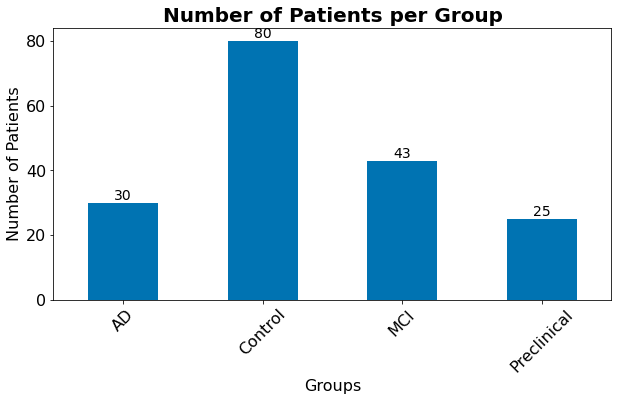

In [8]:
ax=data_class.groupby(
    data_class['biodiag']
)['biodiag'].count().plot(
    kind='bar',
    figsize=(10,5),
    color='#0073b2',
)
ax.set_ylabel("Number of Patients", size=16)
ax.set_xlabel("Groups", size=16)
ax.set_title('Number of Patients per Group',fontweight="bold", size=20)

ax.tick_params(axis = 'x', which = 'major', labelsize = 16,rotation=45)
ax.tick_params(axis = 'y', which = 'major', labelsize = 16)



# label the bars
for p in ax.patches:
    ax.text(p.get_x() + p.get_width()/2., p.get_height(), '%d' % round(p.get_height()), 
        fontsize=14, ha='center', va='bottom')
plt.grid(False)    
plt.show()


### 8.2 Variables with a weak relationship
We plot the variables that seemed to have a weak relationship with the predictor i.e Gender, age and years of education. The motivation was to understand if with a different visualisation we could capture a relationship or if indeed they are not related to the predictor.

#### 8.2.1 Gender
While *MCI* patients have a slightly lower percentage of female patients, there is no strong evidence of a relationship between gender and the group a patient falls into. 

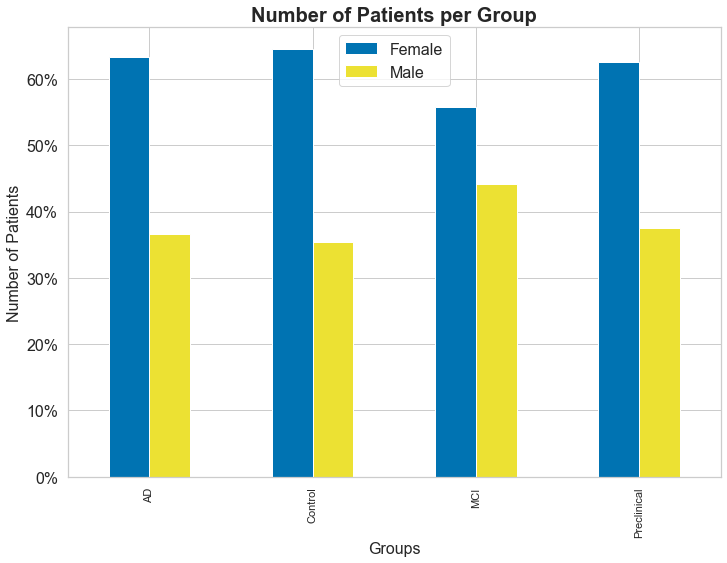

In [17]:
#Setting grid size
sns.set(rc={'figure.figsize':(11.7,8.27)})
#Setting white background
sns.set_style("whitegrid")

import matplotlib.ticker as mtick
ax=data_class.groupby('biodiag')['Sexo']\
    .value_counts(normalize=True)\
    .unstack(level=1)\
    .plot.bar(stacked=False, color=['#0073b2', '#ece133'])
vals = ax.get_yticks()
ax.set_yticklabels(['{:,.0%}'.format(x) for x in vals], size=16)


ax.set_ylabel("Number of Patients", size=16)
ax.set_xlabel("Groups", size=16)
ax.set_title('Number of Patients per Group',fontweight="bold", size=20)
ax.legend(["Female", "Male"],prop={'size': 16});
#ax.set_xticklabels(labels,rotation=45, size=16)



#### 8.2.2 Education
From the below boxplot we see that people with a lower level of education are more inclined to develop cognitive issues. The median number of years of education is lower for the two groups MCI and AD, while it is higher for patients without any cognitive complaints. Furthermore the patients that have spend the longest time in education are in the control group (healthy)

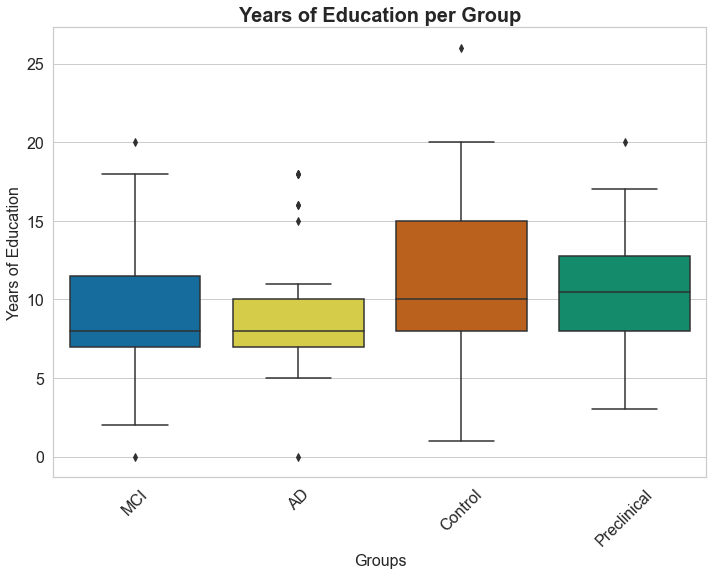

In [16]:
#Define custom colors
my_colors = ["#0073b2", "#ece133", 
             "#d45e03", "#009f73"]
  
# add color array to set_palette
# function of seaborn
sns.set_palette( my_colors )
ax = sns.boxplot(x='biodiag',y="años_escol",data=data_class)


ax.set_ylabel("Years of Education", size=16)
ax.set_xlabel("Groups", size=16)
ax.set_title('Years of Education per Group',fontweight="bold", size=20)
ax.tick_params(axis = 'x', which = 'major', labelsize = 16,rotation=45)
ax.tick_params(axis = 'y', which = 'major', labelsize = 16)




#### 8.2.3 Age
As expected the median age for the control group is the lowest, however intuitively we expected the Alzheimer's Disease group to have the highest median age considering its a degenerative disease of the brain with a gradual loss of memory, which is not the case. Instead MCI and Preclinical have higher median ages, with the Preclinical group having the oldest patient.

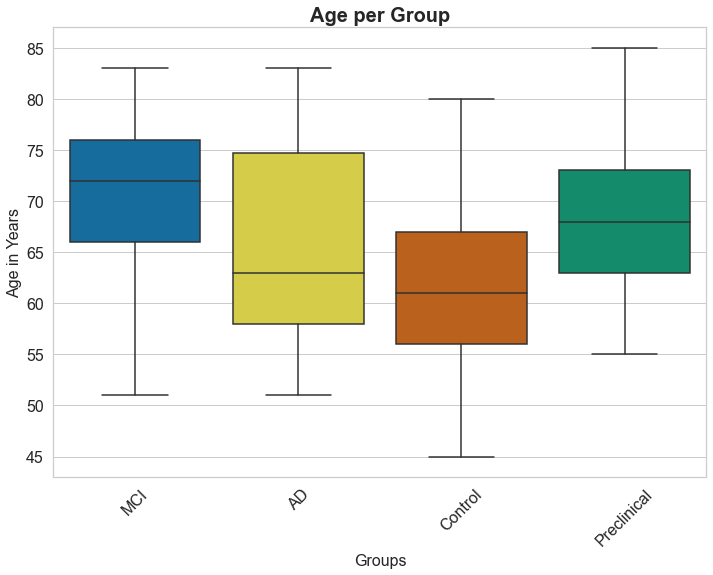

In [18]:
#Define custom colors
my_colors = ["#0073b2", "#ece133", 
             "#d45e03", "#009f73"]
  
# add color array to set_palette
# function of seaborn
sns.set_palette( my_colors )
ax = sns.boxplot(x='biodiag',y="edad",data=data_class)


ax.set_ylabel("Age in Years", size=16)
ax.set_xlabel("Groups", size=16)
ax.set_title('Age per Group',fontweight="bold", size=20)
ax.tick_params(axis = 'x', which = 'major', labelsize = 16,rotation=45)
ax.tick_params(axis = 'y', which = 'major', labelsize = 16)




### 8.3 Variables with a strong relationship
We look at the variables that showed a strong relationship (i.e "Buschke" variables,"flu_anim","fas_total", "Stroop_lect","Stroop_I" and "Clave_num".) with the Amyloid Beta values, which is a primary biomarker for AD and try to understand their relationship with the groupings. 

To achieve this we do two types of graphs
1) Scatterplot - Amyloid Beta vs the individual battery test with the group as a hue. 
2) Boxplot - Groupings and the individual battery test

We find that all variables show similar relationships with Amyloid beta (some with a stronger relationship than others) and thus the groups. The scatterplots show that they all have a positive linear relationship with Amyloid beta. While in the boxplots we see that the median score received in the battery tests per group decreases as the stage of Alzheimer's Disease increases. Hence the individual patients perform worse as their condition also worsens. 

Another important note is that some tests seem better at distinguishing *Control* vs *Preclinical*, for example *Flu_anim* while other variables are not as successful such as *Clave_num*

#### 8.3.1 Buschke AL

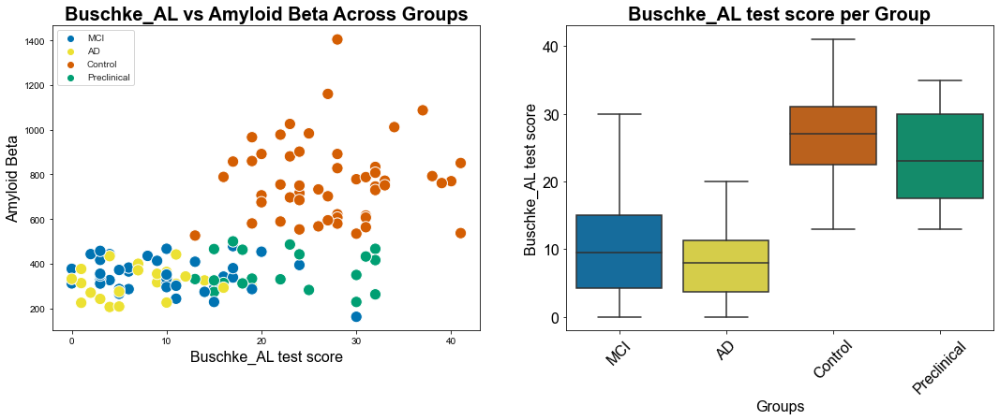

In [12]:
#Setting up the structure of the plots
fig, (ax1,ax2) = plt.subplots(1,2, figsize=(18,6))

#sns.set(rc={'figure.figsize':(12,8.27)})
sns.set_style("whitegrid")

# Set a custom color palette
sns.set_palette(sns.color_palette(my_colors))


#Plot the scatterplot
ax1= sns.scatterplot(
     x='buschke_AL',
     y='AB_42_TUB_B',
     data=data_class,
     hue='biodiag',
     s=150,
     ax=ax1
)

#Fix legend, titles and font sizes 
ax1.legend(loc='upper left')

#ax1 = plt.gca()
ax1.set_ylabel("Amyloid Beta", size=16)
ax1.set_xlabel("Buschke_AL test score", size=16)
ax1.set_title('Buschke_AL vs Amyloid Beta Across Groups', fontweight="bold", size=20)
ax2.tick_params(axis = 'x', which = 'major', labelsize = 16)
ax2.tick_params(axis = 'y', which = 'major', labelsize = 16)


#sns.set_palette( my_colors )
#plot boxplot
ax2 = sns.boxplot(x='biodiag',y="buschke_AL",data=data_class,ax=ax2)

#Fix legend, titles and font sizes 
ax2.set_ylabel("Buschke_AL test score", size=16)
ax2.set_xlabel("Groups", size=16)
ax2.set_title('Buschke_AL test score per Group',fontweight="bold", size=20)
ax2.tick_params(axis = 'x', which = 'major', labelsize = 16,rotation=45)
ax2.tick_params(axis = 'y', which = 'major', labelsize = 16)


#### 8.3.2 flu_anim

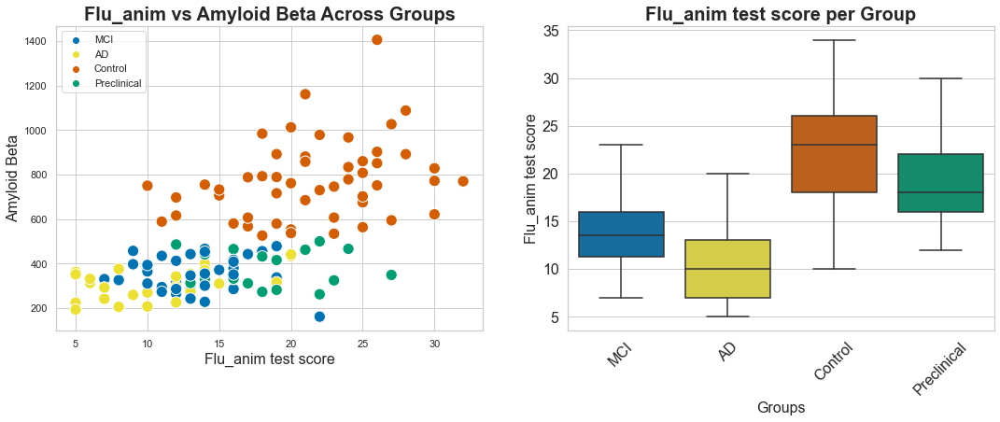

In [128]:
#Setting up the structure of the plots
fig, (ax1,ax2) = plt.subplots(1,2, figsize=(18,6))

#sns.set(rc={'figure.figsize':(12,8.27)})
sns.set_style("whitegrid")

# Set a custom color palette
sns.set_palette(sns.color_palette(my_colors))


#Plot the scatterplot
ax1= sns.scatterplot(
     x='flu_anim',
     y='AB_42_TUB_B',
     data=data_class,
     hue='biodiag',
     s=150,
     ax=ax1
)

#Fix legend, titles and font sizes 
ax1.legend(loc='upper left')

#ax1 = plt.gca()
ax1.set_ylabel("Amyloid Beta", size=16)
ax1.set_xlabel("Flu_anim test score", size=16)
ax1.set_title('Flu_anim vs Amyloid Beta Across Groups', fontweight="bold", size=20)
ax2.tick_params(axis = 'x', which = 'major', labelsize = 16)
ax2.tick_params(axis = 'y', which = 'major', labelsize = 16)


#sns.set_palette( my_colors )
#plot boxplot
ax2 = sns.boxplot(x='biodiag',y="flu_anim",data=data_class,ax=ax2)

#Fix legend, titles and font sizes 
ax2.set_ylabel("Flu_anim test score", size=16)
ax2.set_xlabel("Groups", size=16)
ax2.set_title('Flu_anim test score per Group',fontweight="bold", size=20)
ax2.tick_params(axis = 'x', which = 'major', labelsize = 16,rotation=45)
ax2.tick_params(axis = 'y', which = 'major', labelsize = 16)


#### 8.3.3 fas_total

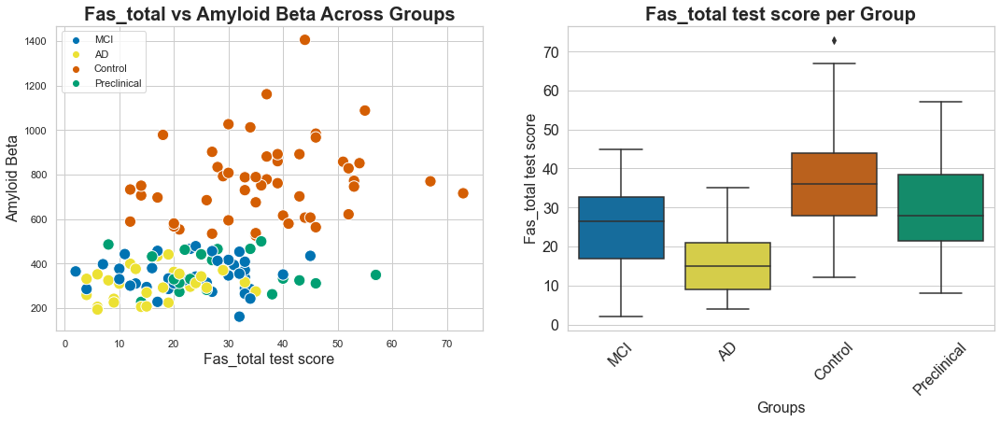

In [129]:
#Setting up the structure of the plots
fig, (ax1,ax2) = plt.subplots(1,2, figsize=(18,6))

#sns.set(rc={'figure.figsize':(12,8.27)})
sns.set_style("whitegrid")

# Set a custom color palette
sns.set_palette(sns.color_palette(my_colors))


#Plot the scatterplot
ax1= sns.scatterplot(
     x='fas_total',
     y='AB_42_TUB_B',
     data=data_class,
     hue='biodiag',
     s=150,
     ax=ax1
)

#Fix legend, titles and font sizes 
ax1.legend(loc='upper left')

#ax1 = plt.gca()
ax1.set_ylabel("Amyloid Beta", size=16)
ax1.set_xlabel("Fas_total test score", size=16)
ax1.set_title('Fas_total vs Amyloid Beta Across Groups', fontweight="bold", size=20)
ax2.tick_params(axis = 'x', which = 'major', labelsize = 16)
ax2.tick_params(axis = 'y', which = 'major', labelsize = 16)


#sns.set_palette( my_colors )
#plot boxplot
ax2 = sns.boxplot(x='biodiag',y="fas_total",data=data_class,ax=ax2)

#Fix legend, titles and font sizes 
ax2.set_ylabel("Fas_total test score", size=16)
ax2.set_xlabel("Groups", size=16)
ax2.set_title('Fas_total test score per Group',fontweight="bold", size=20)
ax2.tick_params(axis = 'x', which = 'major', labelsize = 16,rotation=45)
ax2.tick_params(axis = 'y', which = 'major', labelsize = 16)


#### 8.3.4 Stroop_lect

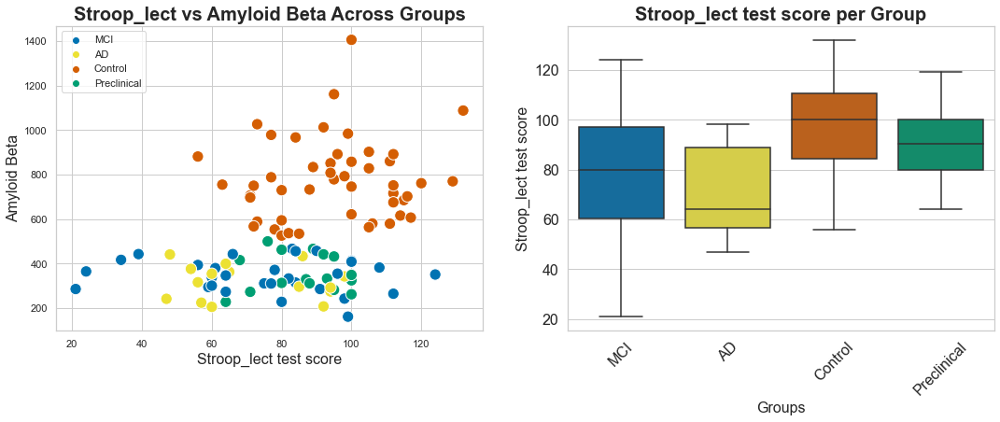

In [130]:
#Setting up the structure of the plots
fig, (ax1,ax2) = plt.subplots(1,2, figsize=(18,6))

#sns.set(rc={'figure.figsize':(12,8.27)})
sns.set_style("whitegrid")

# Set a custom color palette
sns.set_palette(sns.color_palette(my_colors))


#Plot the scatterplot
ax1= sns.scatterplot(
     x='Stroop_lect',
     y='AB_42_TUB_B',
     data=data_class,
     hue='biodiag',
     s=150,
     ax=ax1
)

#Fix legend, titles and font sizes 
ax1.legend(loc='upper left')

#ax1 = plt.gca()
ax1.set_ylabel("Amyloid Beta", size=16)
ax1.set_xlabel("Stroop_lect test score", size=16)
ax1.set_title('Stroop_lect vs Amyloid Beta Across Groups', fontweight="bold", size=20)
ax2.tick_params(axis = 'x', which = 'major', labelsize = 16)
ax2.tick_params(axis = 'y', which = 'major', labelsize = 16)


#sns.set_palette( my_colors )
#plot boxplot
ax2 = sns.boxplot(x='biodiag',y="Stroop_lect",data=data_class,ax=ax2)

#Fix legend, titles and font sizes 
ax2.set_ylabel("Stroop_lect test score", size=16)
ax2.set_xlabel("Groups", size=16)
ax2.set_title('Stroop_lect test score per Group',fontweight="bold", size=20)
ax2.tick_params(axis = 'x', which = 'major', labelsize = 16,rotation=45)
ax2.tick_params(axis = 'y', which = 'major', labelsize = 16)


#### 8.3.5 Clave_num

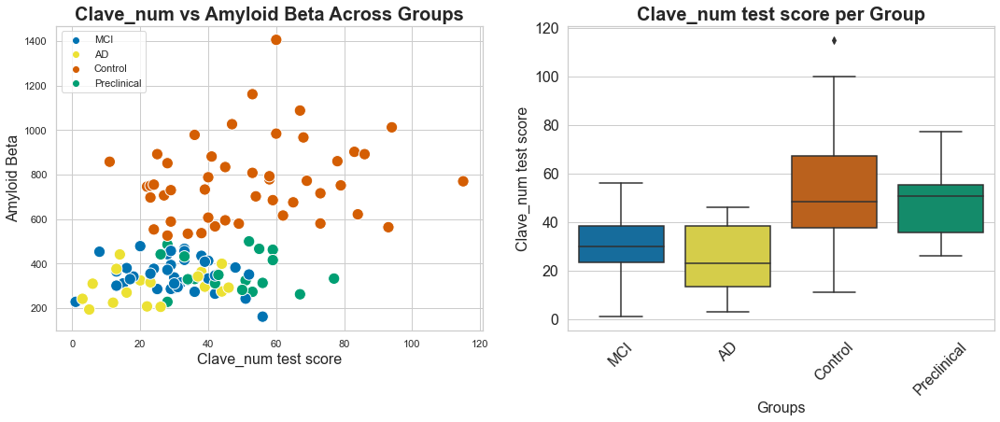

In [20]:
#Setting up the structure of the plots
fig, (ax1,ax2) = plt.subplots(1,2, figsize=(18,6))

#sns.set(rc={'figure.figsize':(12,8.27)})
sns.set_style("whitegrid")

# Set a custom color palette
sns.set_palette(sns.color_palette(my_colors))


#Plot the scatterplot
ax1= sns.scatterplot(
     x='Clave_num',
     y='AB_42_TUB_B',
     data=data_class,
     hue='biodiag',
     s=150,
     ax=ax1
)

#Fix legend, titles and font sizes 
ax1.legend(loc='upper left')

#ax1 = plt.gca()
ax1.set_ylabel("Amyloid Beta", size=16)
ax1.set_xlabel("Clave_num test score", size=16)
ax1.set_title('Clave_num vs Amyloid Beta Across Groups', fontweight="bold", size=20)
ax2.tick_params(axis = 'x', which = 'major', labelsize = 16)
ax2.tick_params(axis = 'y', which = 'major', labelsize = 16)


#sns.set_palette( my_colors )
#plot boxplot
ax2 = sns.boxplot(x='biodiag',y="Clave_num",data=data_class,ax=ax2)

#Fix legend, titles and font sizes 
ax2.set_ylabel("Clave_num test score", size=16)
ax2.set_xlabel("Groups", size=16)
ax2.set_title('Clave_num test score per Group',fontweight="bold", size=20)
ax2.tick_params(axis = 'x', which = 'major', labelsize = 16,rotation=45)
ax2.tick_params(axis = 'y', which = 'major', labelsize = 16)


#### 8.3.6 Putting all the battery tests (with a strong relationship) together
Considering that all of the battery tests we analyzed in this section were related to Amyloid Beta and thus the grouping, we wanted to understand if there was also a relationship between variables themselves.

To do this we done a scatterplot of the variables and as we expected the variables are indeed positively related. 

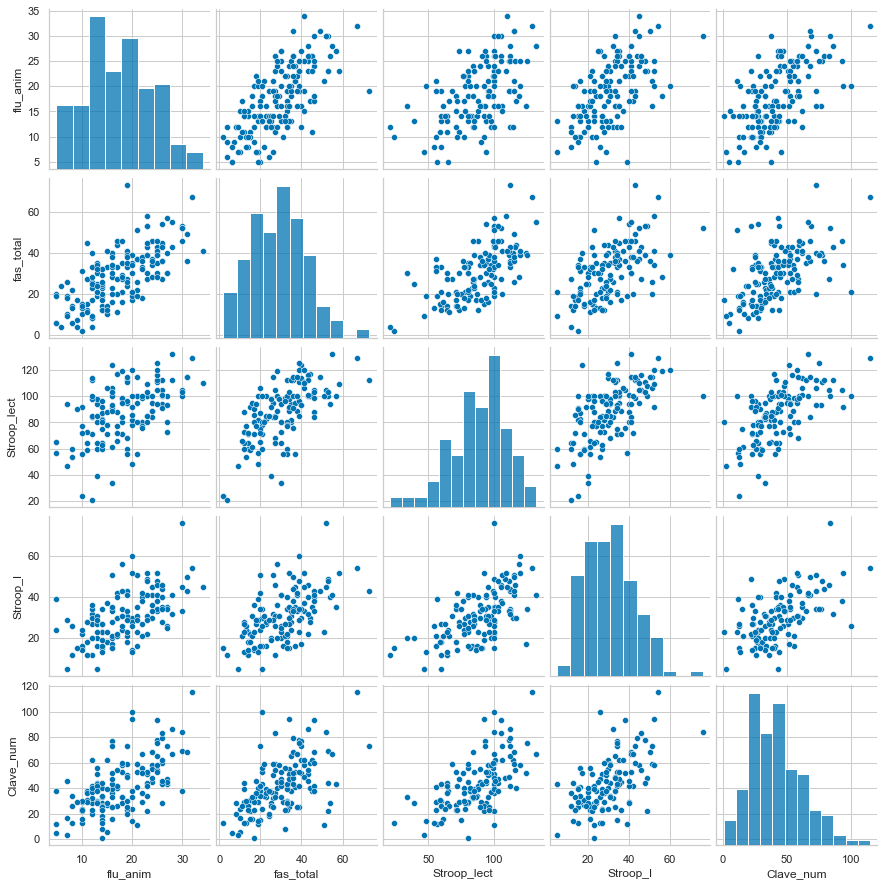

In [19]:
pairpot_data=data_class[["flu_anim","fas_total","Stroop_lect","Stroop_I", "Clave_num"]]
sns.set_palette(sns.color_palette(my_colors))
ax=sns.pairplot(data=pairpot_data)